# Wstęp

Niestety pakiety Innvestigate nie wspiera naszej sieci w takiej postaci jaką ją zaimplementowaliśmy. Wykorzystywała ona zmodyfikowaną wersję BatchNormalization, którą musieliśmy zastąpić analogiczną warstwą z kerasa.  
Ale największym problemem jest funkcja aktywacji SoftMax, która była ostatnią warstwą. Innvestigate nie wspiera SoftMaxa i musieliśmy zmienić funkcję aktywacji. Przetestowaliśmy `sigmoid`, `relu`, `tanh`. Dla `tanh` sieć nie wytrenowała się, bo funkcja loss zwracała NaN.

|Funkcja aktywacji|Balanced accuracy|
|:-:|:-:|
|SoftMax|0.97|
|Sigmoid|0.70|
|Relu|0.85|

Wyjaśniamy dwie z tych sieci sieć w ramach pracy domowej, ale w praktycznych zastosowaniach taki spadek accuracy jest dyskwalifikujący dla metody wyjaśnień.

# Sieć z sigmoidem

### Różne metody z pakietu innvestigate na tym samym obrazku

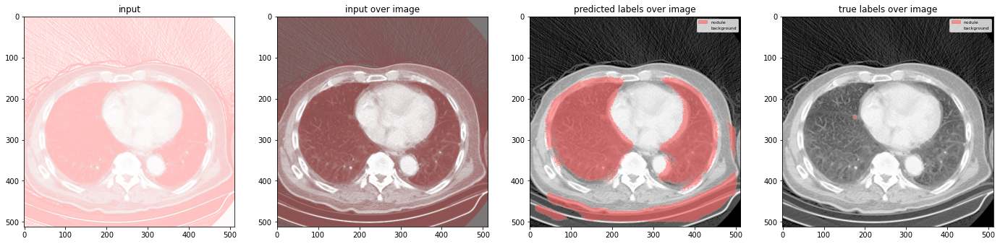

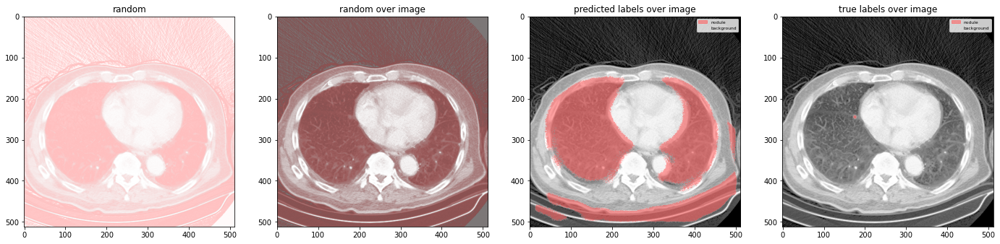

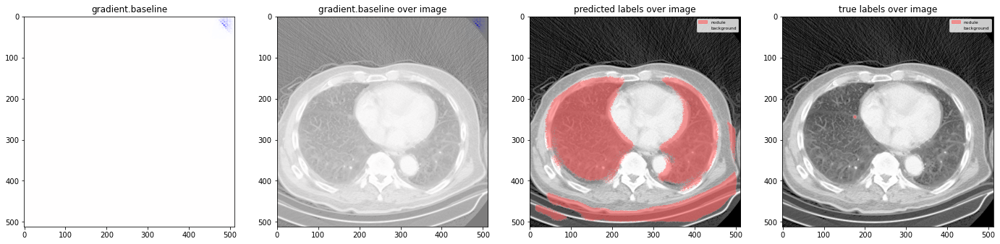

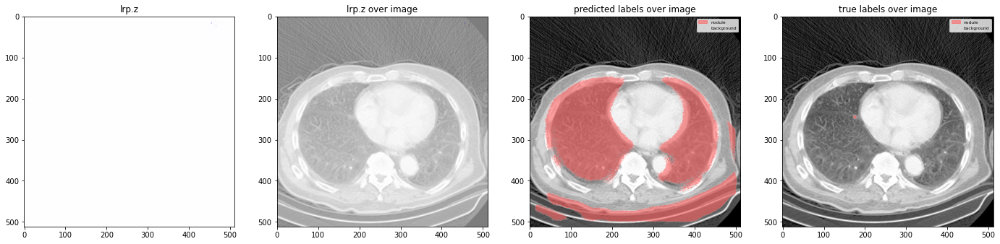

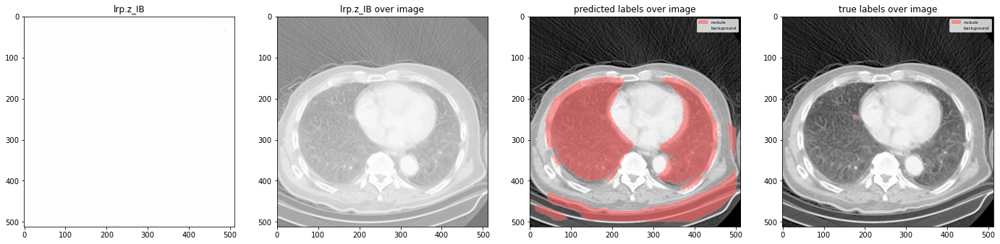

...

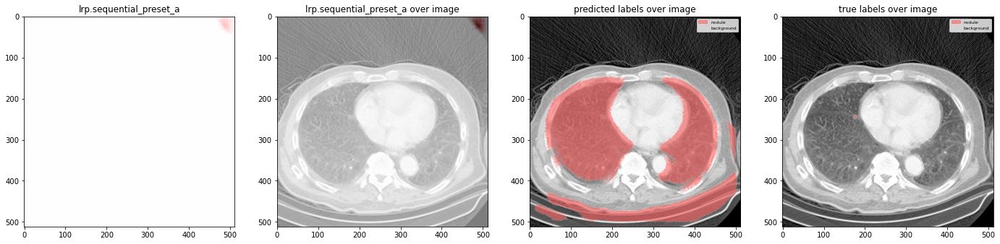

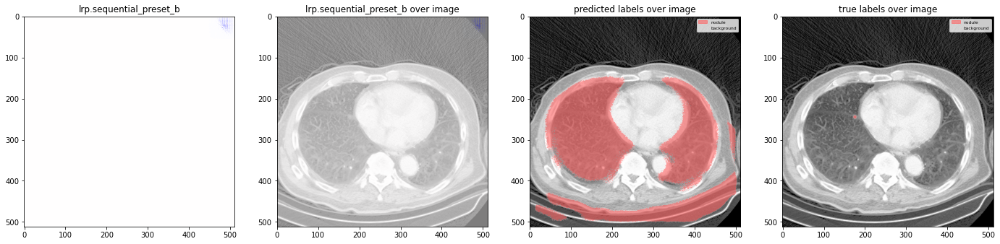

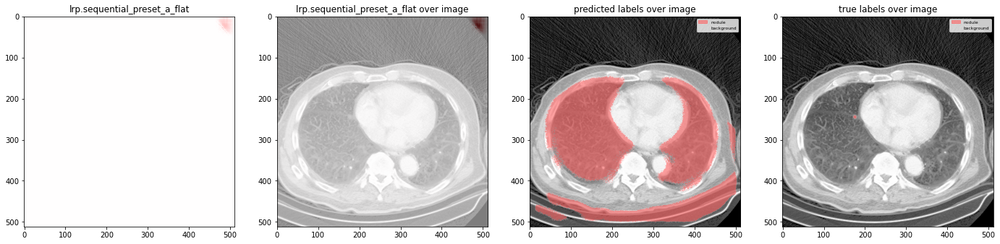

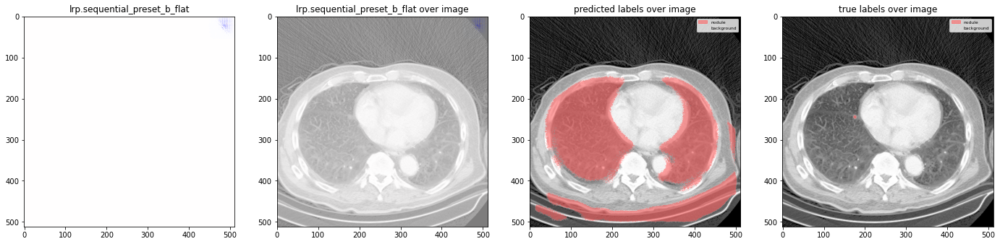

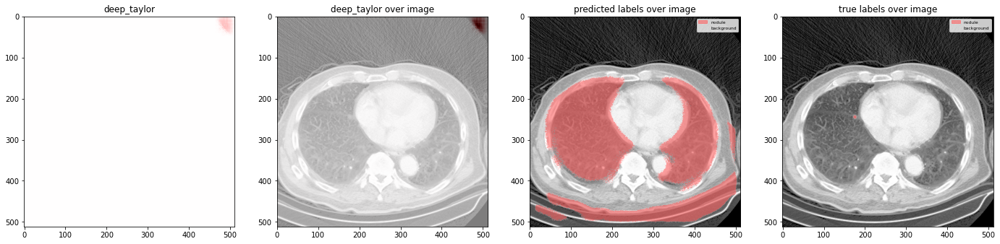

In [26]:
all_labels = ['nodule', 'background']
colors = np.asarray([[255,100,100,155], [255,255,255,0]]) / 255.

for r in results.keys():
    a = results[r]
    a = a.sum(axis=np.argmax(np.asarray(a.shape) == 3))
    a /= np.max(np.abs(a))
    plt.rcParams["figure.figsize"] = (24,6)
    
    plt.subplot(1, 4, 1)
    plt.imshow(a[0], cmap=map_object, clim=(-1, 1))
    plt.title(r)
    
    plt.subplot(1, 4, 2)
    plt.imshow(np.squeeze(X),cmap='gray')
    plt.imshow(a[0], cmap=map_object, clim=(-1, 1))
    plt.title(r + ' over image')
    
    plt.subplot(1, 4, 3)
    Y_pred = model.predict(img)
    Y_lbls = np.argmax(Y_pred,axis=-1)
    plt.imshow(np.squeeze(X),cmap='gray')
    plt.imshow(colors[np.squeeze(Y_lbls)])
    plt.legend(handles=[mpatches.Patch(color=colors[i], label=all_labels[i]) for i in np.unique(Y_lbls)], prop={'size':6})
    plt.title('predicted labels over image')
    
    plt.subplot(1, 4, 4)
    Y_truth = np.argmax(Y,axis=-1)
    plt.imshow(np.squeeze(X),cmap='gray')
    plt.imshow(colors[np.squeeze(Y_truth)])
    plt.legend(handles=[mpatches.Patch(color=colors[i], label=all_labels[i]) for i in np.unique(Y_lbls)], prop={'size':6})
    plt.title('true labels over image')

    plt.show()

### Metoda Deep Taylor na kilku obrazkach

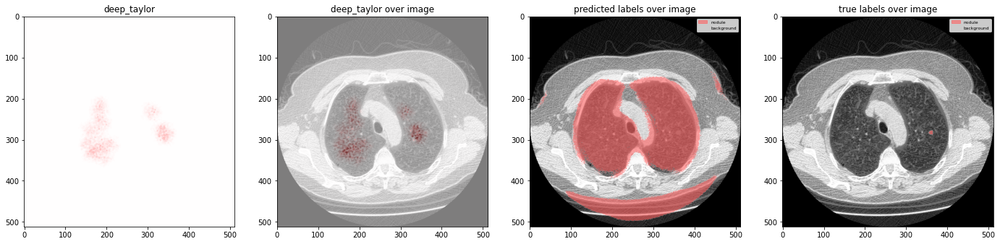

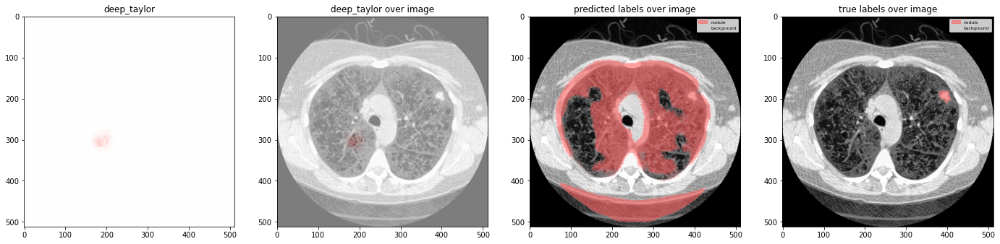

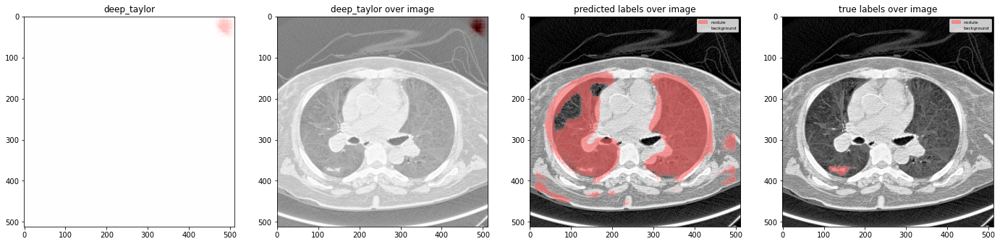

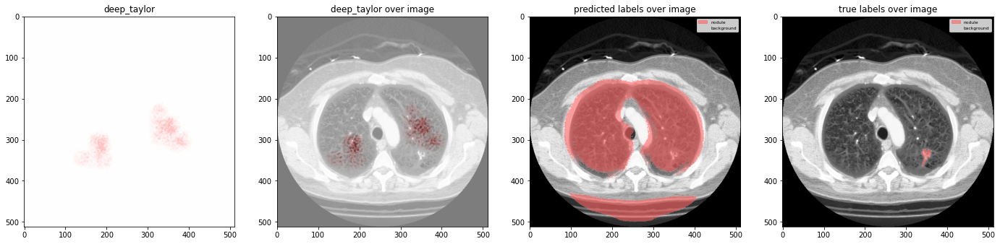

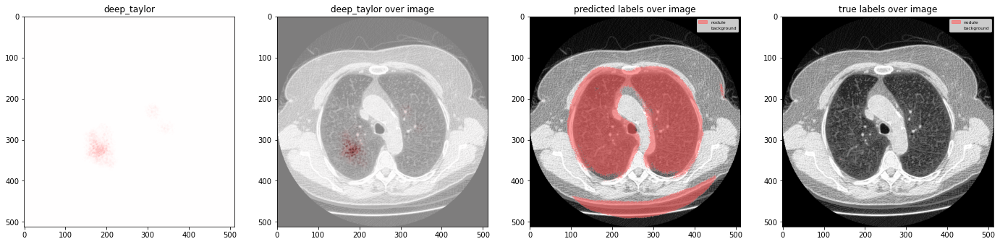

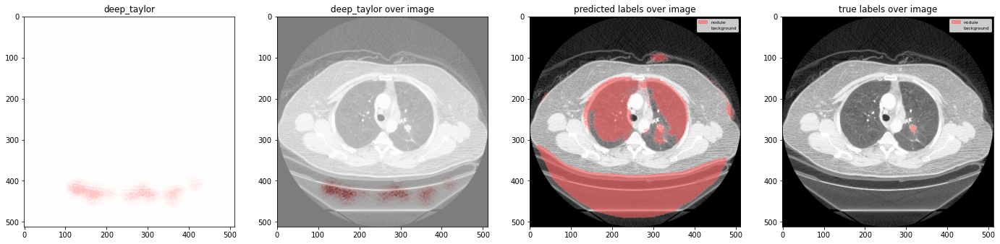

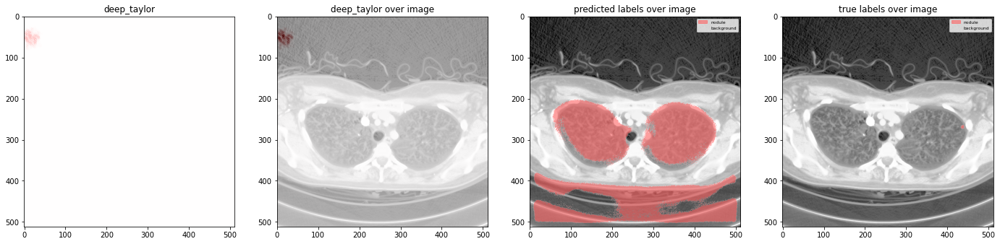

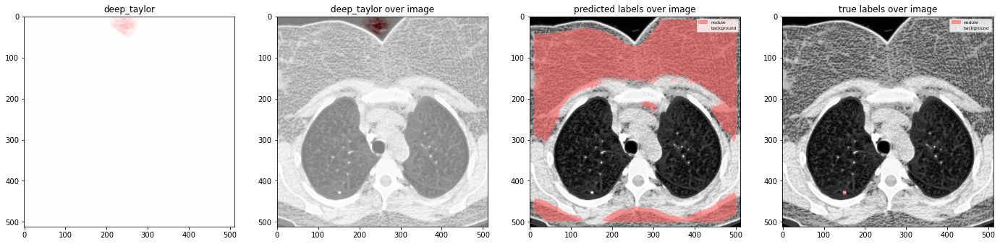

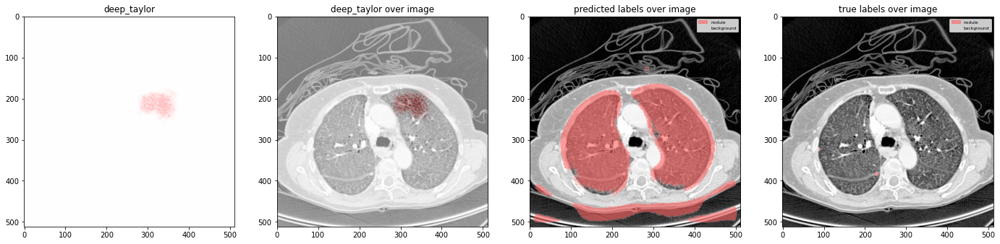

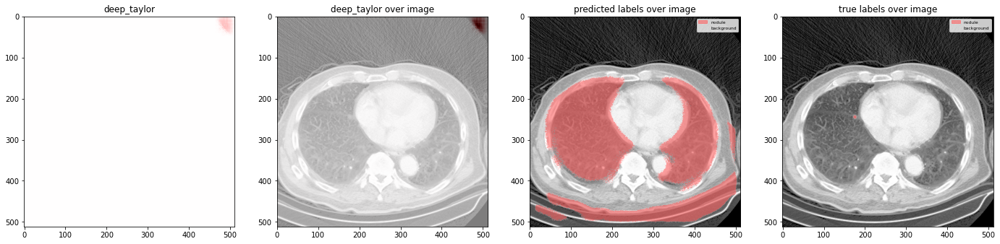

In [22]:
all_labels = ['nodule', 'background']
colors = np.asarray([[255,100,100,155], [255,255,255,0]]) / 255.
for i in range(10):
    obs = np.random.choice(len(db['X']))
    X = db['X'][obs]
    Y = db['Y'][obs]
    img = to_three_layers(X)[None, :, :, :]
    a = analyzer.analyze(img)
    a = a.sum(axis=np.argmax(np.asarray(a.shape) == 3))
    a /= np.max(np.abs(a))
    plt.rcParams["figure.figsize"] = (24,6)
    
    plt.subplot(1, 4, 1)
    plt.imshow(a[0], cmap=map_object, clim=(-1, 1))
    plt.title('deep_taylor')
    
    plt.subplot(1, 4, 2)
    plt.imshow(np.squeeze(X),cmap='gray')
    plt.imshow(a[0], cmap=map_object, clim=(-1, 1))
    plt.title('deep_taylor over image')
    
    plt.subplot(1, 4, 3)
    Y_pred = model.predict(img)
    Y_lbls = np.argmax(Y_pred,axis=-1)
    plt.imshow(np.squeeze(X),cmap='gray')
    plt.imshow(colors[np.squeeze(Y_lbls)])
    plt.legend(handles=[mpatches.Patch(color=colors[i], label=all_labels[i]) for i in np.unique(Y_lbls)], prop={'size':6})
    plt.title('predicted labels over image')
    
    plt.subplot(1, 4, 4)
    Y_truth = np.argmax(Y,axis=-1)
    plt.imshow(np.squeeze(X),cmap='gray')
    plt.imshow(colors[np.squeeze(Y_truth)])
    plt.legend(handles=[mpatches.Patch(color=colors[i], label=all_labels[i]) for i in np.unique(Y_lbls)], prop={'size':6})
    plt.title('true labels over image')

    plt.show()

### Komentarz:
Wyjaśnienia sugerują, że sieć uczy się rozpoznawać charakterystyczne struktury wewnątrz płuc, żeby móc oznaczyć całe wnętrze w predykcji.  
Na niektórych obrazkach podobne fragmenty są poza płucami i wtedy sieć oznacza obszery poz płucami.
Naniektórych obrazkach też widać, że sieć nauczyła się jakiegoś artegaktu w narożniku.

# Sieć z relu

## Różne metody na jednym obrazku

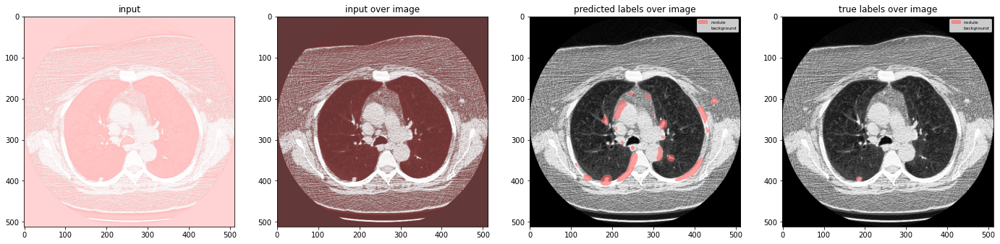

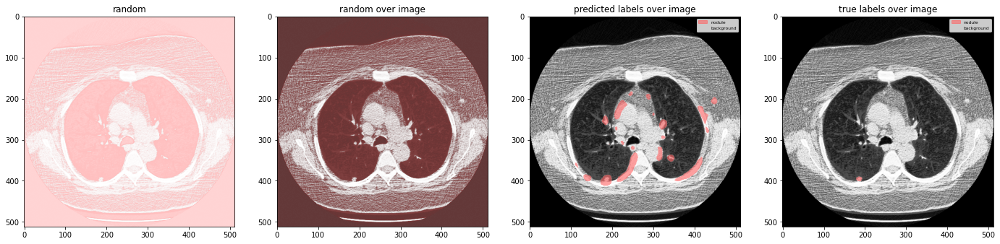

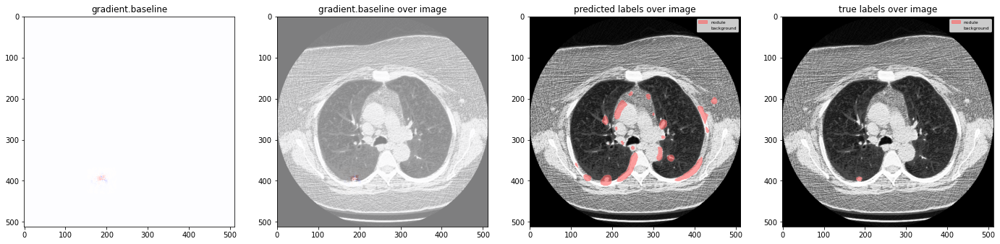

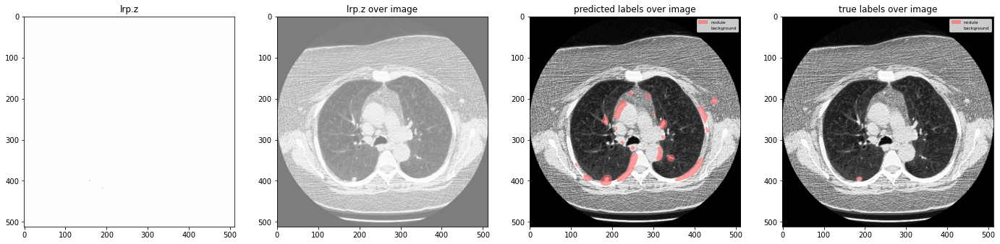

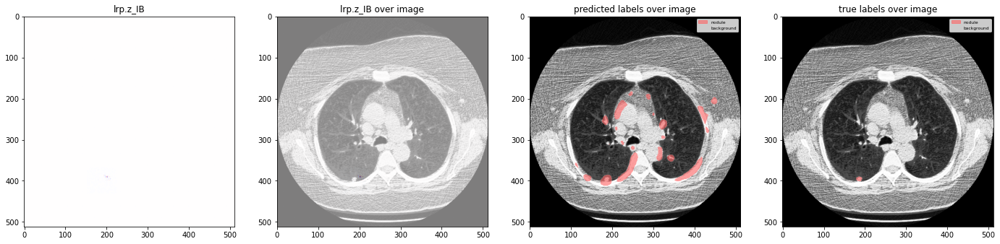

...

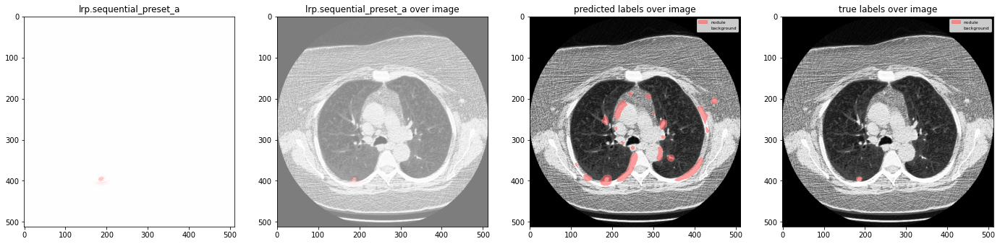

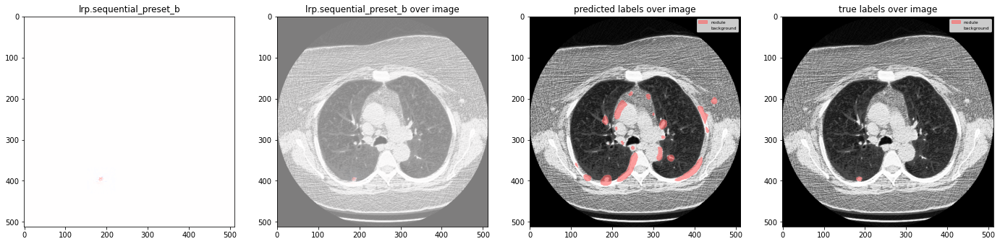

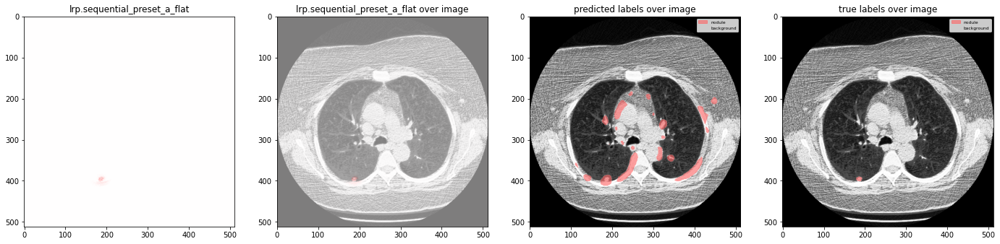

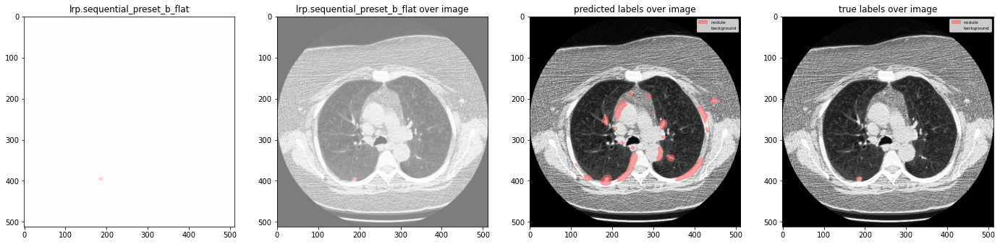

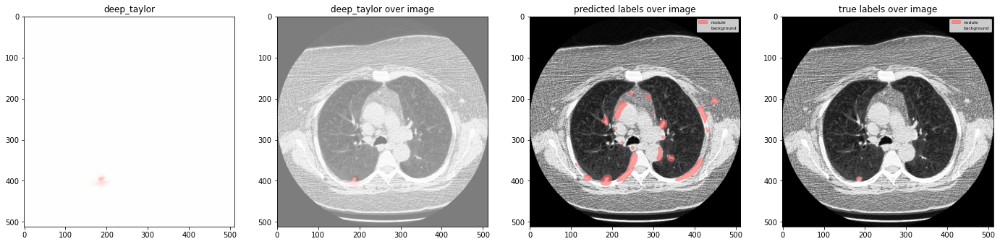

In [37]:
all_labels = ['nodule', 'background']
colors = np.asarray([[255,100,100,155], [255,255,255,0]]) / 255.

for r in results.keys():
    a = results[r]
    a = a.sum(axis=np.argmax(np.asarray(a.shape) == 3))
    a /= np.max(np.abs(a))
    plt.rcParams["figure.figsize"] = (24,6)
    
    plt.subplot(1, 4, 1)
    plt.imshow(a[0], cmap=map_object, clim=(-1, 1))
    plt.title(r)
    
    plt.subplot(1, 4, 2)
    plt.imshow(np.squeeze(X),cmap='gray')
    plt.imshow(a[0], cmap=map_object, clim=(-1, 1))
    plt.title(r + ' over image')
    
    plt.subplot(1, 4, 3)
    Y_pred = model.predict(img)
    Y_lbls = np.argmax(Y_pred,axis=-1)
    plt.imshow(np.squeeze(X),cmap='gray')
    plt.imshow(colors[np.squeeze(Y_lbls)])
    plt.legend(handles=[mpatches.Patch(color=colors[i], label=all_labels[i]) for i in np.unique(Y_lbls)], prop={'size':6})
    plt.title('predicted labels over image')
    
    plt.subplot(1, 4, 4)
    Y_truth = np.argmax(Y,axis=-1)
    plt.imshow(np.squeeze(X),cmap='gray')
    plt.imshow(colors[np.squeeze(Y_truth)])
    plt.legend(handles=[mpatches.Patch(color=colors[i], label=all_labels[i]) for i in np.unique(Y_lbls)], prop={'size':6})
    plt.title('true labels over image')

    plt.show()

## Deep Taylor na różnych obrazkach

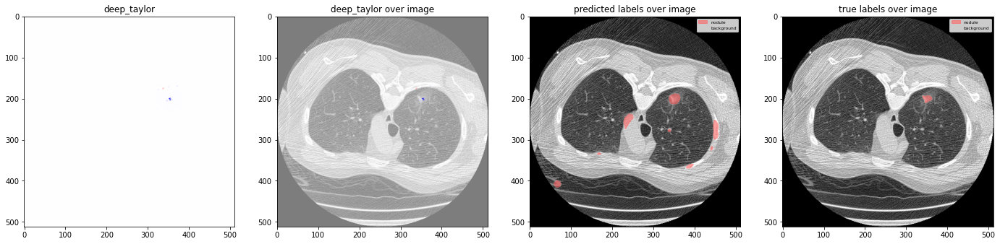

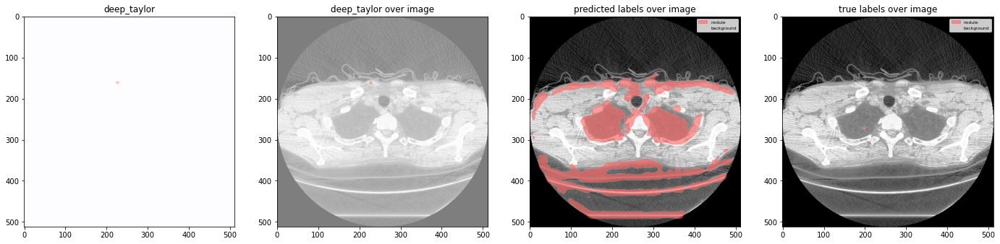

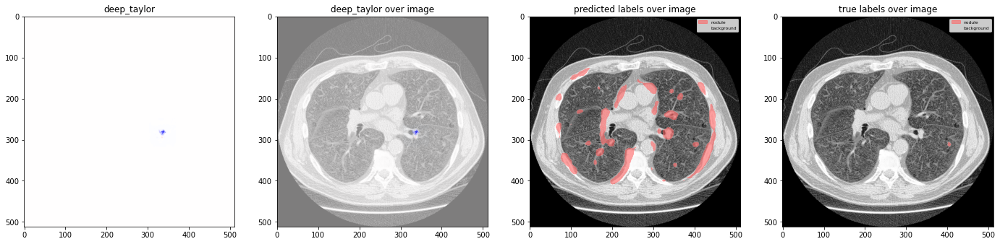

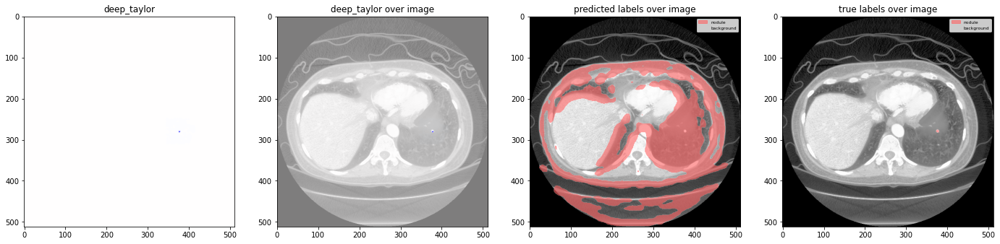

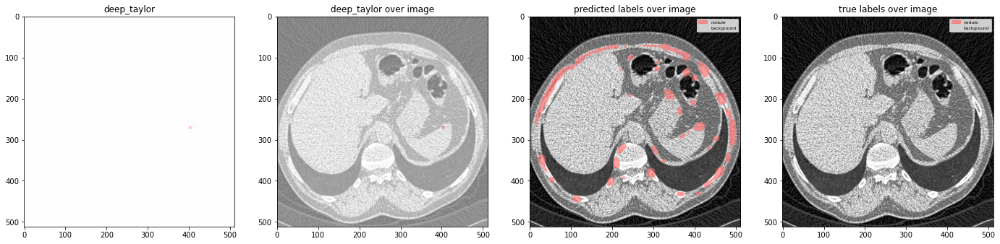

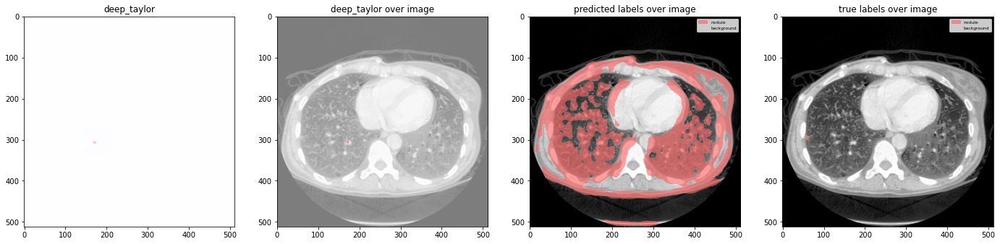

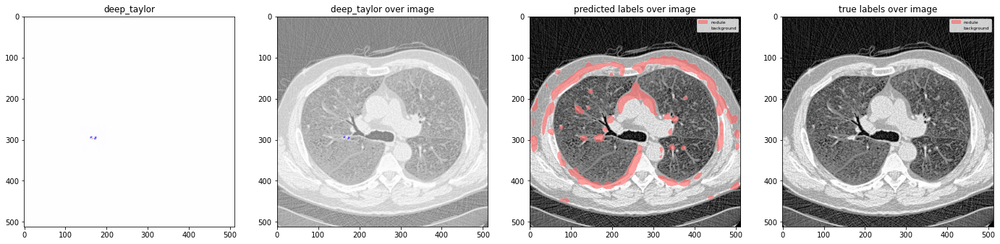

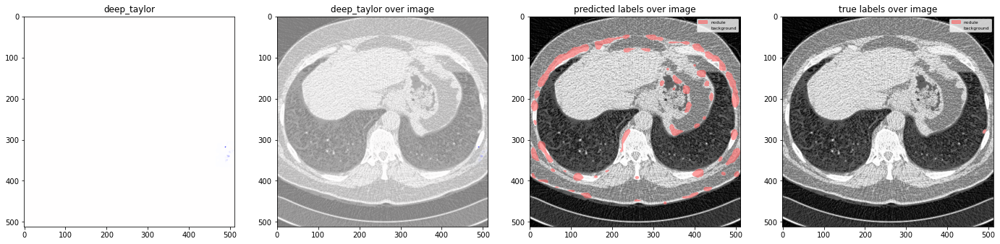

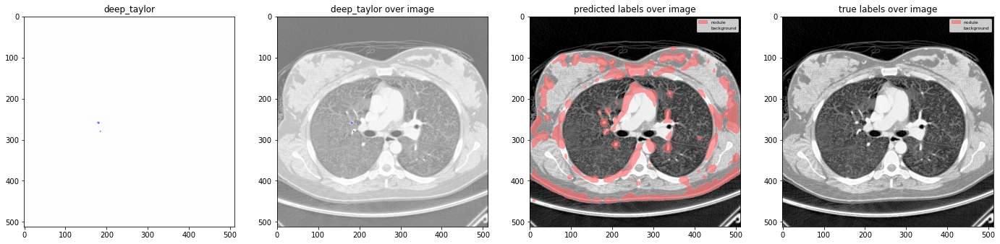

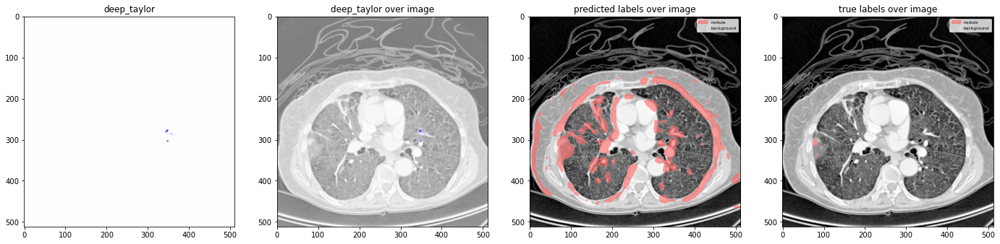

In [29]:
all_labels = ['nodule', 'background']
colors = np.asarray([[255,100,100,155], [255,255,255,0]]) / 255.
for i in range(10):
    obs = np.random.choice(len(db['X']))
    X = db['X'][obs]
    Y = db['Y'][obs]
    img = to_three_layers(X)[None, :, :, :]
    a = analyzer.analyze(img)
    a = a.sum(axis=np.argmax(np.asarray(a.shape) == 3))
    a /= np.max(np.abs(a))
    plt.rcParams["figure.figsize"] = (24,6)
    
    plt.subplot(1, 4, 1)
    plt.imshow(a[0], cmap=map_object, clim=(-1, 1))
    plt.title('deep_taylor')
    
    plt.subplot(1, 4, 2)
    plt.imshow(np.squeeze(X),cmap='gray')
    plt.imshow(a[0], cmap=map_object, clim=(-1, 1))
    plt.title('deep_taylor over image')
    
    plt.subplot(1, 4, 3)
    Y_pred = model.predict(img)
    Y_lbls = np.argmax(Y_pred,axis=-1)
    plt.imshow(np.squeeze(X),cmap='gray')
    plt.imshow(colors[np.squeeze(Y_lbls)])
    plt.legend(handles=[mpatches.Patch(color=colors[i], label=all_labels[i]) for i in np.unique(Y_lbls)], prop={'size':6})
    plt.title('predicted labels over image')
    
    plt.subplot(1, 4, 4)
    Y_truth = np.argmax(Y,axis=-1)
    plt.imshow(np.squeeze(X),cmap='gray')
    plt.imshow(colors[np.squeeze(Y_truth)])
    plt.legend(handles=[mpatches.Patch(color=colors[i], label=all_labels[i]) for i in np.unique(Y_lbls)], prop={'size':6})
    plt.title('true labels over image')

    plt.show()

### Komentarz:
Dla tej s